<a href="https://colab.research.google.com/github/ofer1992/siren_clip/blob/main/styleclip_siren_image_optimization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# StyleCLIP + SIREN

describe bla bla bla

**References**:
- [DeepDaze notebook](https://colab.research.google.com/drive/1Qq6FKycoVTbNVBgz-fuOlDvGjEh4T5V7?authuser=1#scrollTo=piJOg9MY7khd)
-  [SIREN notebook](https://colab.research.google.com/github/vsitzmann/siren/blob/master/explore_siren.ipynb)
- [CLIP notebook](https://colab.research.google.com/github/openai/clip/blob/master/notebooks/Interacting_with_CLIP.ipynb)
- [styleCLIP global notebook](https://colab.research.google.com/github/orpatashnik/StyleCLIP/blob/main/notebooks/StyleCLIP_global.ipynb)
- [styleCLIP optimization code](https://github.com/orpatashnik/StyleCLIP/blob/0d177126fe0227f12af0b53e627fc22231b73f19/optimization/run_optimization.py)

## Imports and setup

Am I going to have issues with versions? I see in CLIP notebook they require pytorch>=1.7.1, and both DeepDaze and styleCLIP notebooks install specifically pytorch 1.7.1. It might be because JIT only works in that version.

In [1]:
#@title Setup pytorch (restart afterwards, taken from DeepDaze)

# %%script false --no-raise-error
import subprocess

CUDA_version = [s for s in subprocess.check_output(["nvcc", "--version"]).decode("UTF-8").split(", ") if s.startswith("release")][0].split(" ")[-1]
print("CUDA version:", CUDA_version)

if CUDA_version == "10.0":
    torch_version_suffix = "+cu100"
elif CUDA_version == "10.1":
    torch_version_suffix = "+cu101"
elif CUDA_version == "10.2":
    torch_version_suffix = ""
else:
    torch_version_suffix = "+cu110"

! pip install torch==1.7.1{torch_version_suffix} torchvision==0.8.2{torch_version_suffix} -f https://download.pytorch.org/whl/torch_stable.html ftfy regex

CUDA version: 11.0
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |███████████████████████         | 834.1 MB 1.4 MB/s eta 0:03:48tcmalloc: large alloc 1147494400 bytes == 0x55a61fb04000 @  0x7fc278e79615 0x55a5e6aab02c 0x55a5e6b8b17a 0x55a5e6aade4d 0x55a5e6b9fc0d 0x55a5e6b220d8 0x55a5e6b1cc35 0x55a5e6aaf73a 0x55a5e6b21f40 0x55a5e6b1cc35 0x55a5e6aaf73a 0x55a5e6b1e93b 0x55a5e6ba0a56 0x55a5e6b1dfb3 0x55a5e6ba0a56 0x55a5e6b1dfb3 0x55a5e6ba0a56 0x55a5e6b1dfb3 0x55a5e6aafb99 0x55a5e6af2e79 0x55a5e6aae7b2 0x55a5e6b21e65 0x55a5e6b1cc35 0x55a5e6aaf73a 0x55a5e6b1e93b 0x55a5e6b1cc35 0x55a5e6aaf73a 0x55a5e6b1db0e 0x55a5e6aaf65a 0x55a5e6b1dd67 0x55a5e6b1cc35
     |█████████████████████████████▏  | 1055.7 MB 1.4 MB/s eta 0:01:11tcmalloc: large alloc 1434370048 bytes == 0x55a66415a000 @  0x7fc278e79615 0x55a5e6aab02c 0x55a5e6b8b17a 0x55a5e6aade4d 0x55a5e6b9fc0d 0x55a5e6b220d8 0x55a5e6b1cc35 0x55a5e6aaf73a 0x55a5e6b21f40 0x55a5e6b1cc35 0x55a5e6aaf73a 0x55a5e6b1e93b 0x55a5e6

In [2]:
! pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-is0xjhhj
  Running command git clone -q https://github.com/openai/CLIP.git /tmp/pip-req-build-is0xjhhj
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369079 sha256=0e50983b42a56fd9cb6b1782909f0259f0a3a4654d87ea07e9e17803683ac476
  Stored in directory: /tmp/pip-ephem-wheel-cache-dlkt50hz/wheels/fd/b9/c3/5b4470e35ed76e174bff77c92f91da82098d5e35fd5bc8cdac
Successfully built clip


In [9]:
import os
import torch
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as T
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image


if not os.path.isfile("/content/obama.jpg"):
  !wget https://ichef.bbci.co.uk/news/976/cpsprodpb/9B30/production/_119782793_gettyimages-1227843827.jpg
  !mv _119782793_gettyimages-1227843827.jpg obama.jpg
if not os.path.isfile("/content/obama_better.pkl"):
  !cp /content/drive/MyDrive/lab/siren_clip/obama_better.pkl /content/"

In [10]:
#@title SIREN def
#@markdown I'm using code directly from DeepDaze notebook instead of a module implementation, just to have code in front of me.

#@markdown Keep in mind:
#@markdown - layers is a param. in SIREN paper it was 5, in deep daze 16 was recommended.
#@markdown - $\omega_0$ is a hyperparameter that can affect success. by default it is 30 and I think it is the right value for images.
import torch.nn as nn

class SineLayer(nn.Module):
    # See paper sec. 3.2, final paragraph, and supplement Sec. 1.5 for discussion of omega_0.
    
    # If is_first=True, omega_0 is a frequency factor which simply multiplies the activations before the 
    # nonlinearity. Different signals may require different omega_0 in the first layer - this is a 
    # hyperparameter.
    
    # If is_first=False, then the weights will be divided by omega_0 so as to keep the magnitude of 
    # activations constant, but boost gradients to the weight matrix (see supplement Sec. 1.5)
    
    def __init__(self, in_features, out_features, bias=True,
                 is_first=False, omega_0=30):
        super().__init__()
        self.omega_0 = omega_0
        self.is_first = is_first
        
        self.in_features = in_features
        self.linear = nn.Linear(in_features, out_features, bias=bias)
        
        self.init_weights()
    
    def init_weights(self):
        with torch.no_grad():
            if self.is_first:
                self.linear.weight.uniform_(-1 / self.in_features, 
                                             1 / self.in_features)      
            else:
                self.linear.weight.uniform_(-np.sqrt(6 / self.in_features) / self.omega_0, 
                                             np.sqrt(6 / self.in_features) / self.omega_0)
        
    def forward(self, input):
        return torch.sin(self.omega_0 * self.linear(input))
    
    def forward_with_intermediate(self, input): 
        # For visualization of activation distributions
        intermediate = self.omega_0 * self.linear(input)
        return torch.sin(intermediate), intermediate
    
    
class Siren(nn.Module):
    def __init__(self, in_features, hidden_features, hidden_layers, out_features, outermost_linear=True, 
                 first_omega_0=30, hidden_omega_0=30.):
        super().__init__()
        
        self.net = []
        self.net.append(SineLayer(in_features, hidden_features, 
                                  is_first=True, omega_0=first_omega_0))

        for i in range(hidden_layers):
            self.net.append(SineLayer(hidden_features, hidden_features, 
                                      is_first=False, omega_0=hidden_omega_0))

        if outermost_linear:
            final_linear = nn.Linear(hidden_features, out_features)
            
            with torch.no_grad():
                final_linear.weight.uniform_(-np.sqrt(6 / hidden_features) / hidden_omega_0, 
                                              np.sqrt(6 / hidden_features) / hidden_omega_0)
                
            self.net.append(final_linear)
        else:
            self.net.append(SineLayer(hidden_features, out_features, 
                                      is_first=False, omega_0=hidden_omega_0))
        
        self.net = nn.Sequential(*self.net)
    
    def forward(self, coords):
        coords = coords.clone().detach().requires_grad_(True) # allows to take derivative w.r.t. input
        output = self.net(coords)
        return output, coords      

    def forward_with_activations(self, coords, retain_grad=False):
        '''Returns not only model output, but also intermediate activations.
        Only used for visualizing activations later!'''
        activations = OrderedDict()

        activation_count = 0
        x = coords.clone().detach().requires_grad_(True)
        activations['input'] = x
        for i, layer in enumerate(self.net):
            if isinstance(layer, SineLayer):
                x, intermed = layer.forward_with_intermediate(x)
                
                if retain_grad:
                    x.retain_grad()
                    intermed.retain_grad()
                    
                activations['_'.join((str(layer.__class__), "%d" % activation_count))] = intermed
                activation_count += 1
            else: 
                x = layer(x)
                
                if retain_grad:
                    x.retain_grad()
                    
            activations['_'.join((str(layer.__class__), "%d" % activation_count))] = x
            activation_count += 1

        return activations


def get_mgrid(sidelen, dim=2):
    '''Generates a flattened grid of (x,y,...) coordinates in a range of -1 to 1.
    sidelen: int
    dim: int'''
    tensors = tuple(dim * [torch.linspace(-1, 1, steps=sidelen)])
    mgrid = torch.stack(torch.meshgrid(*tensors), dim=-1)
    mgrid = mgrid.reshape(-1, dim)
    return mgrid

## Fitting the image to a SIREN

In [12]:
net = Siren(2, 256, 5, 3).cuda()

[dataset ref](https://pytorch.org/docs/stable/data.html) READ

In [11]:
def get_obama_tensor(sidelength):
  from torchvision.transforms import Resize, Compose, ToTensor, Normalize
  img = plt.imread('obama.jpg')
  img = img[:512, 200:712,:]
  img = Image.fromarray(img)        
  transform = Compose([
      Resize(sidelength),
      ToTensor(),
      Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
  ])
  img = transform(img)
  return img

class ImageFitting(Dataset):
  def __init__(self, sidelength):
    super().__init__()
    img = get_obama_tensor(sidelength)
    self.pixels = img.permute(1, 2, 0).view(-1, 3) # flatten while keeping channel dim
    self.coords = get_mgrid(sidelength, 2)

  def __len__(self):
    return 1

  def __getitem__(self, idx):
    if idx > 0: raise IndexError
    return self.coords, self.pixels # i guess one batch


In [13]:
sideX = 256
obama = ImageFitting(sideX)
dataloader = DataLoader(obama, batch_size=1, pin_memory=True, num_workers=0)

### Optimization loop

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 0, Total loss 0.000373


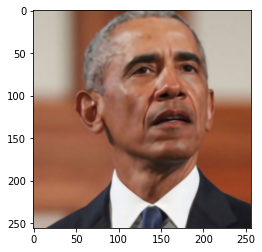

Step 10, Total loss 0.003632


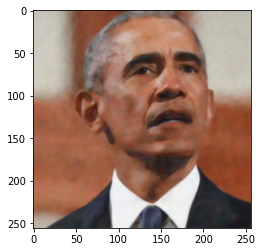

Step 20, Total loss 0.001555


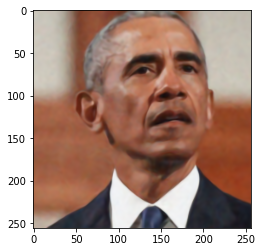

Step 30, Total loss 0.000865


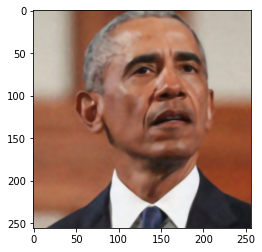

Step 40, Total loss 0.000614


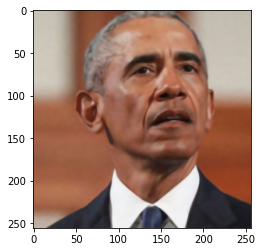

Step 50, Total loss 0.000483


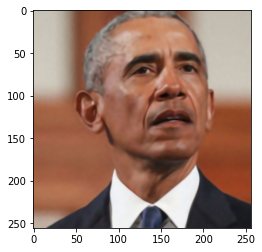

Step 60, Total loss 0.000415


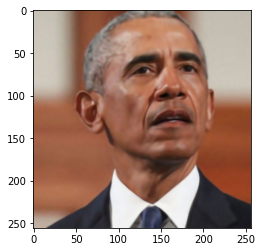

Step 70, Total loss 0.000374


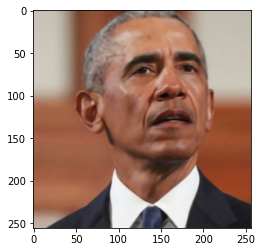

Step 80, Total loss 0.000347


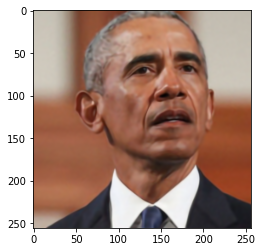

Step 90, Total loss 0.000327


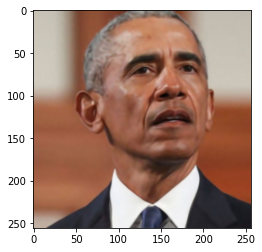

Step 100, Total loss 0.000310


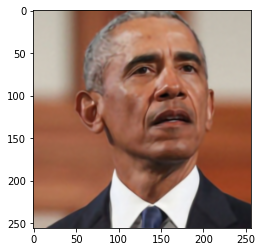

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 110, Total loss 0.000297


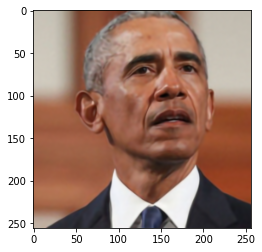

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 120, Total loss 0.000285


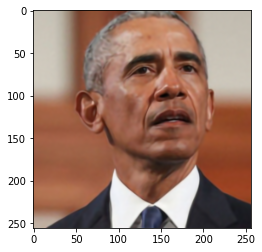

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 130, Total loss 0.000274


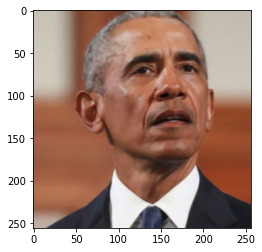

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 140, Total loss 0.000264


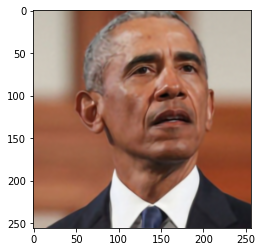

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 150, Total loss 0.000256


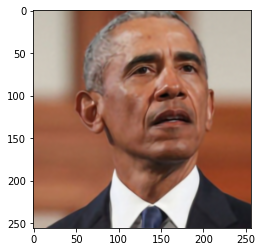

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 160, Total loss 0.000248


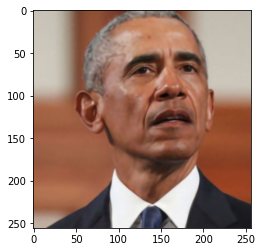

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 170, Total loss 0.000240


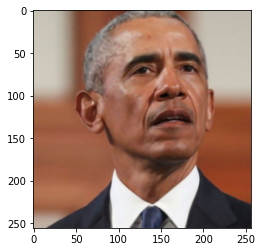

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 180, Total loss 0.000233


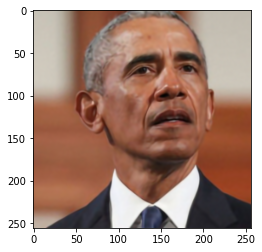

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 190, Total loss 0.000227


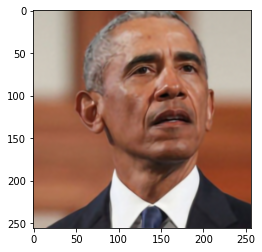

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 200, Total loss 0.000221


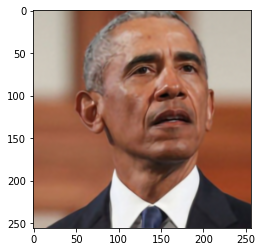

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 210, Total loss 0.000215


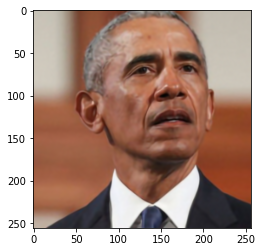

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 220, Total loss 0.000210


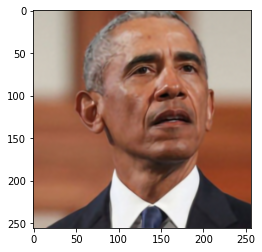

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 230, Total loss 0.000205


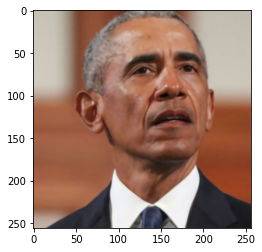

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 240, Total loss 0.000200


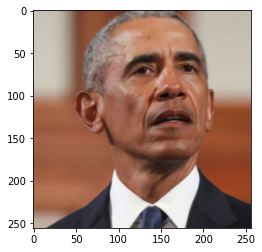

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 250, Total loss 0.000195


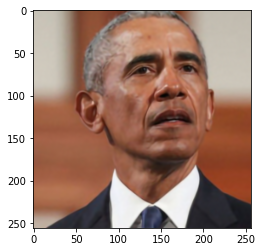

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 260, Total loss 0.000191


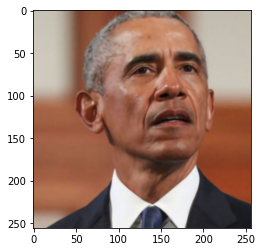

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 270, Total loss 0.000186


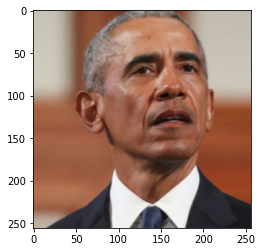

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 280, Total loss 0.000182


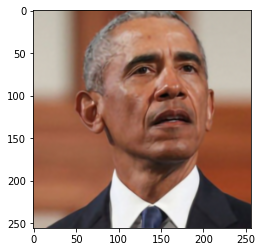

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 290, Total loss 0.000178


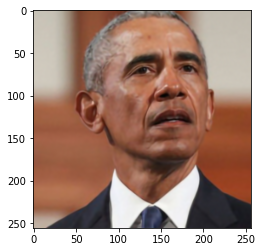

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 300, Total loss 0.000174


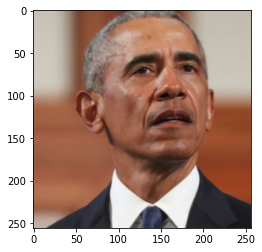

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 310, Total loss 0.000170


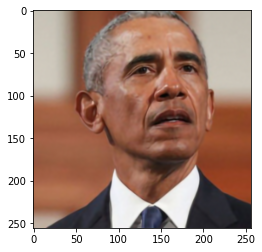

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 320, Total loss 0.000167


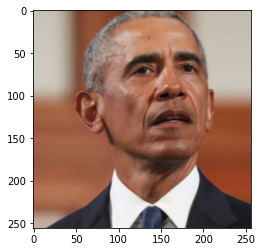

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 330, Total loss 0.000163


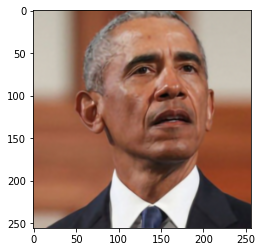

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 340, Total loss 0.000284


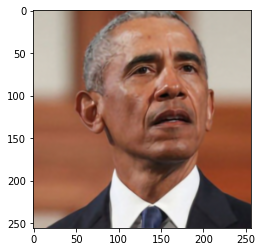

Step 350, Total loss 0.000171


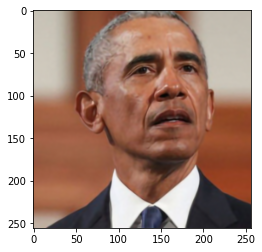

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 360, Total loss 0.000162


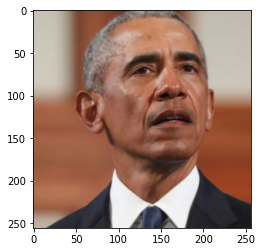

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 370, Total loss 0.000153


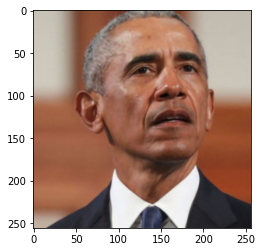

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 380, Total loss 0.000148


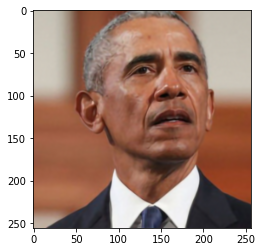

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 390, Total loss 0.000144


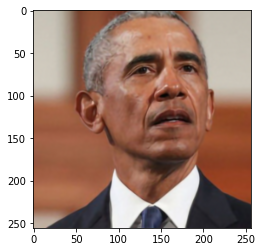

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 400, Total loss 0.000141


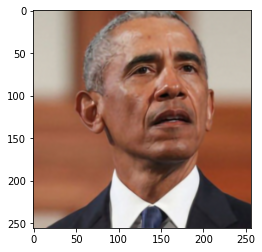

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 410, Total loss 0.000138


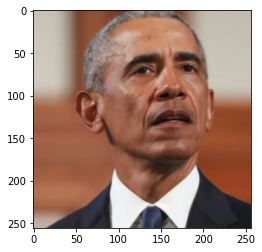

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 420, Total loss 0.000135


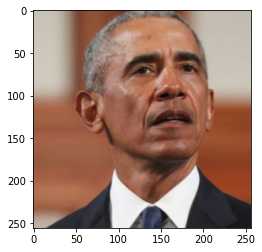

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 430, Total loss 0.000132


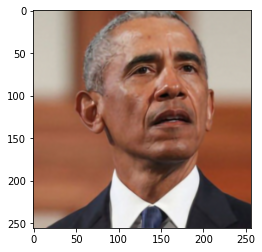

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 440, Total loss 0.000130


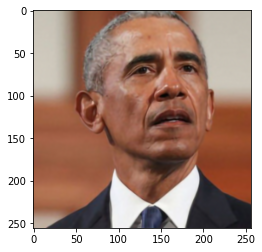

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 450, Total loss 0.000127


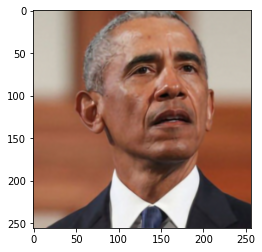

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 460, Total loss 0.000124


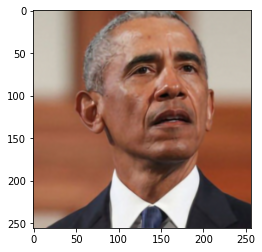

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 470, Total loss 0.000122


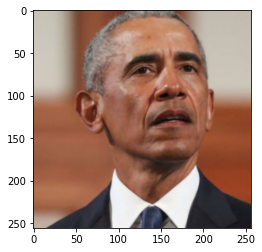

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 480, Total loss 0.000119


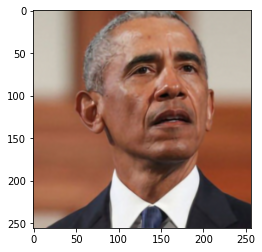

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 490, Total loss 0.000117


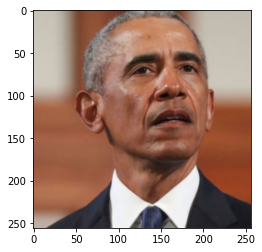

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 500, Total loss 0.000115


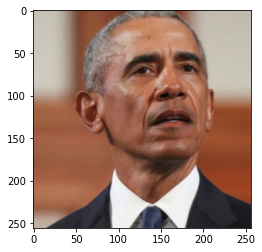

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 510, Total loss 0.000112


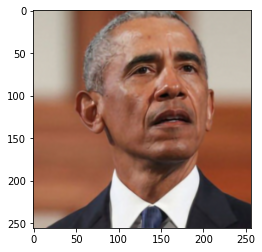

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 520, Total loss 0.000111


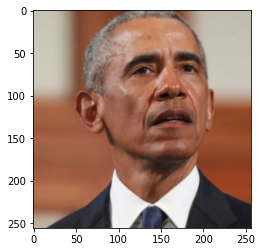

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 530, Total loss 0.000155


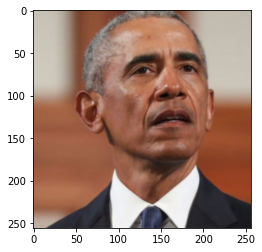

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 540, Total loss 0.000121


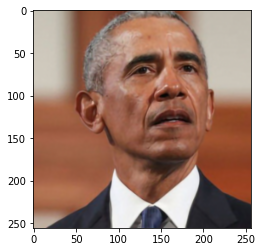

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 550, Total loss 0.000109


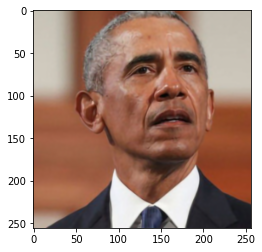

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 560, Total loss 0.000104


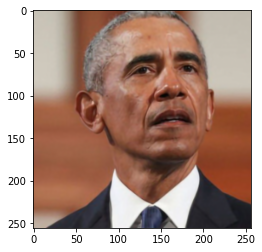

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 570, Total loss 0.000101


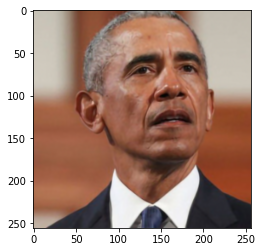

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 580, Total loss 0.000098


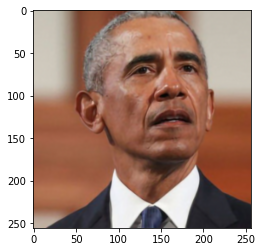

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 590, Total loss 0.000096


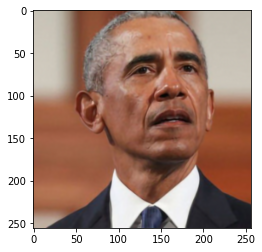

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 600, Total loss 0.000095


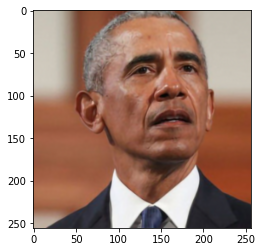

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 610, Total loss 0.000093


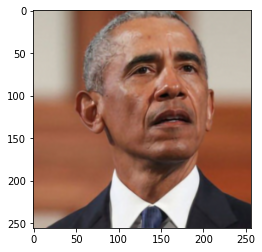

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 620, Total loss 0.000091


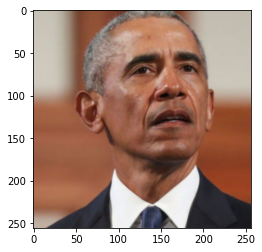

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 630, Total loss 0.000089


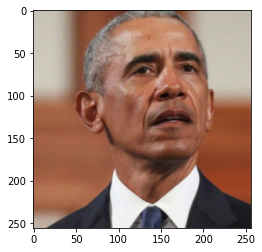

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 640, Total loss 0.000088


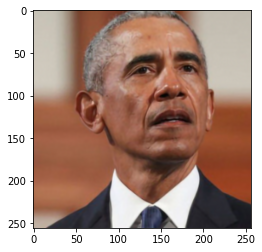

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 650, Total loss 0.000086


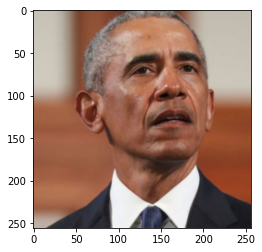

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 660, Total loss 0.000084


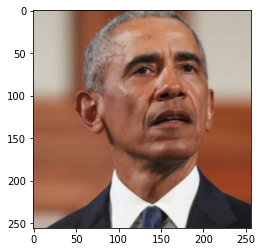

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 670, Total loss 0.000083


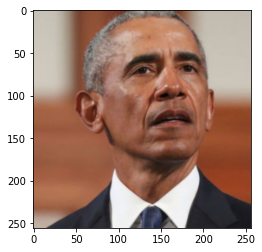

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 680, Total loss 0.000081


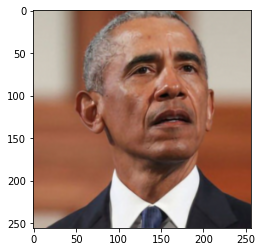

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 690, Total loss 0.000080


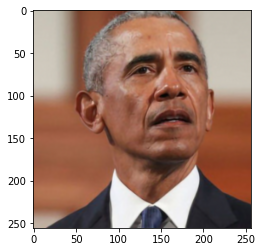

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 700, Total loss 0.000078


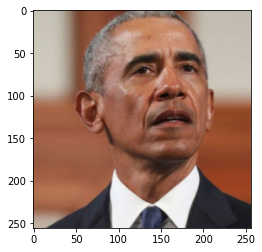

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 710, Total loss 0.000077


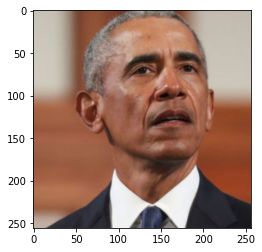

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 720, Total loss 0.000075


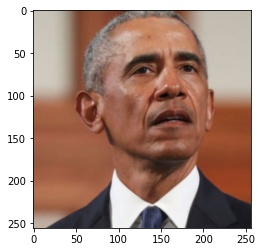

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 730, Total loss 0.000074


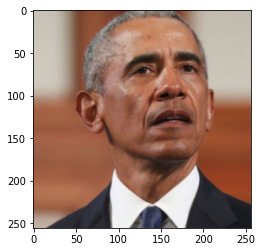

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 740, Total loss 0.000073


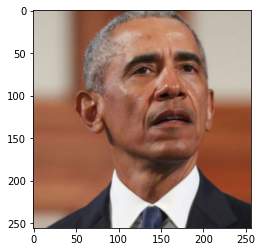

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 750, Total loss 0.000257


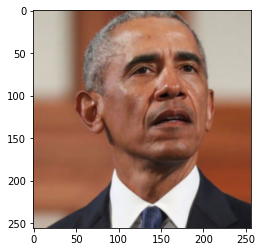

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 760, Total loss 0.000095


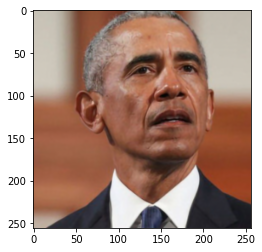

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 770, Total loss 0.000077


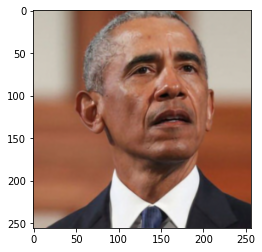

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 780, Total loss 0.000071


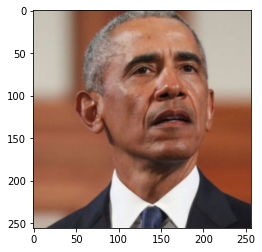

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 790, Total loss 0.000068


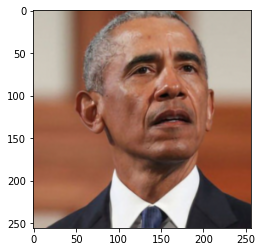

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 800, Total loss 0.000066


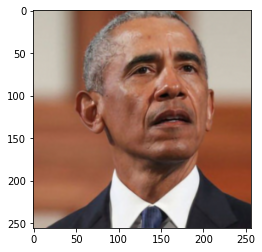

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 810, Total loss 0.000065


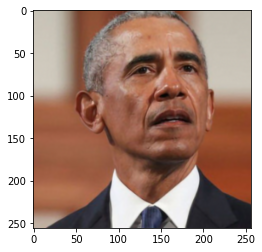

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 820, Total loss 0.000063


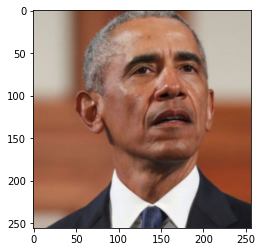

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 830, Total loss 0.000062


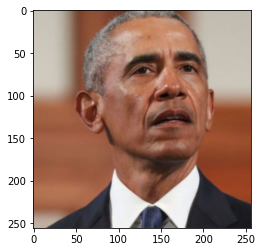

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 840, Total loss 0.000061


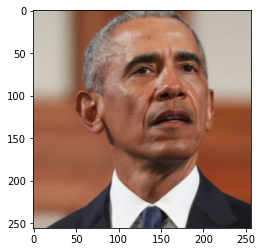

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 850, Total loss 0.000060


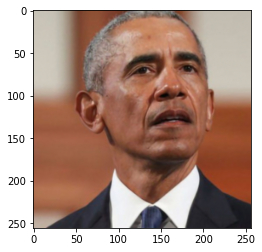

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 860, Total loss 0.000059


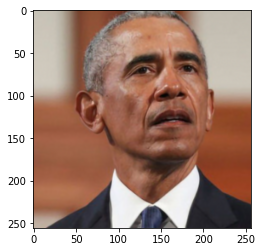

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 870, Total loss 0.000058


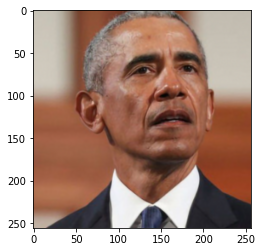

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 880, Total loss 0.000057


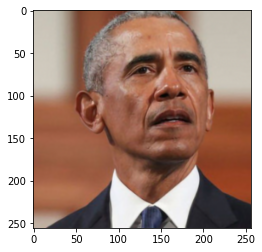

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 890, Total loss 0.000075


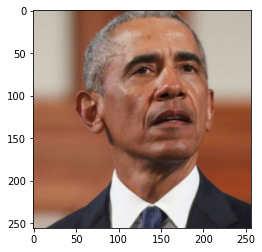

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 900, Total loss 0.000058


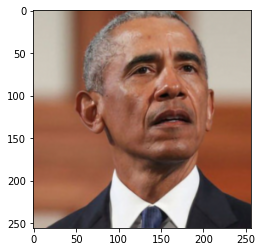

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 910, Total loss 0.000056


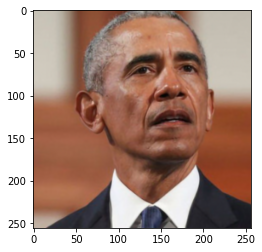

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 920, Total loss 0.000054


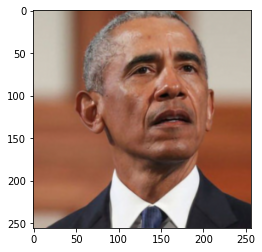

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 930, Total loss 0.000053


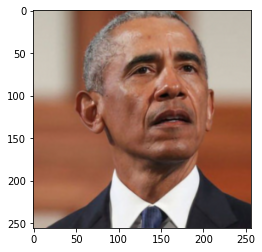

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 940, Total loss 0.000052


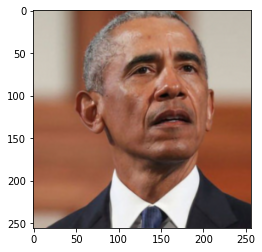

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 950, Total loss 0.000051


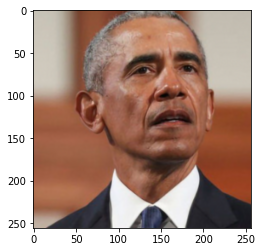

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 960, Total loss 0.000079


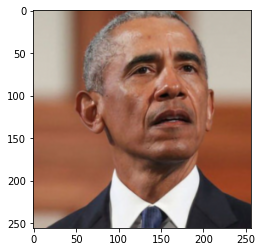

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 970, Total loss 0.000058


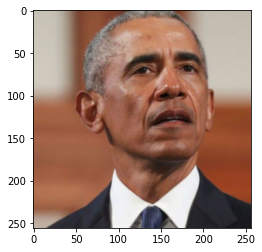

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 980, Total loss 0.000052


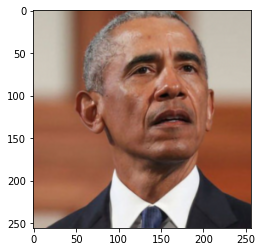

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 990, Total loss 0.000049


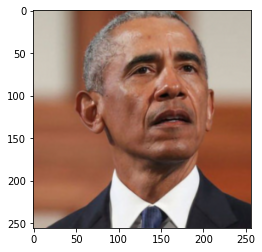

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1000, Total loss 0.000047


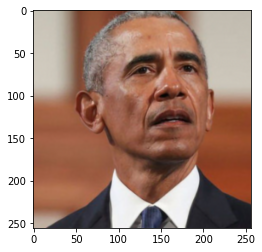

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1010, Total loss 0.000046


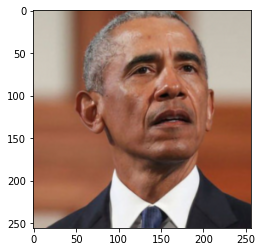

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1020, Total loss 0.000045


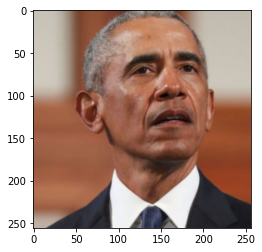

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1030, Total loss 0.000044


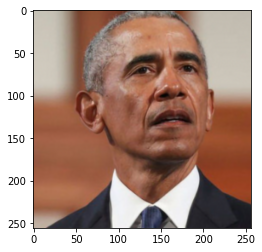

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1040, Total loss 0.000057


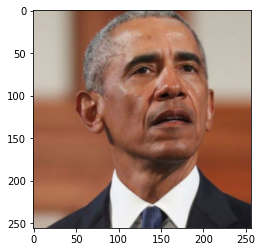

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1050, Total loss 0.000063


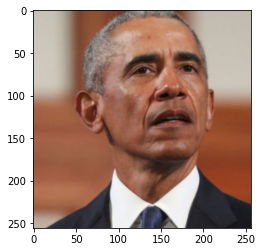

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1060, Total loss 0.000050


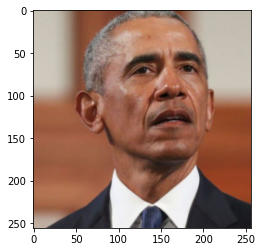

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1070, Total loss 0.000044


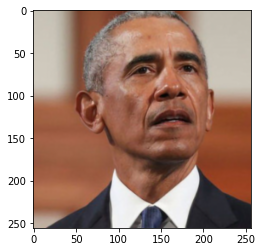

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1080, Total loss 0.000042


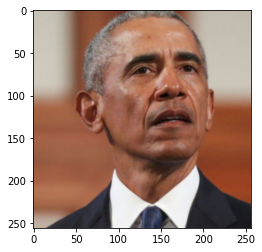

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1090, Total loss 0.000041


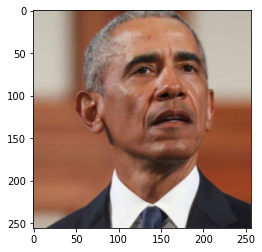

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1100, Total loss 0.000040


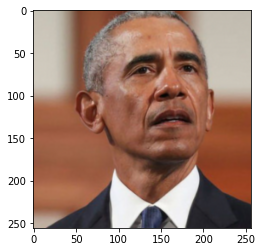

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1110, Total loss 0.000039


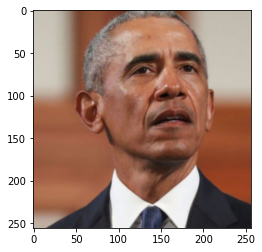

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1120, Total loss 0.000038


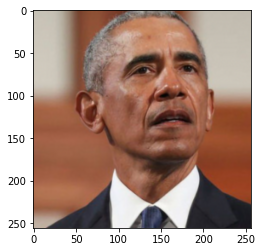

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1130, Total loss 0.000038


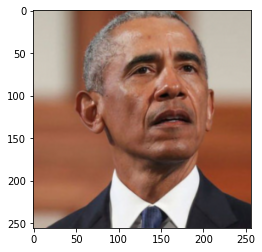

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1140, Total loss 0.000087


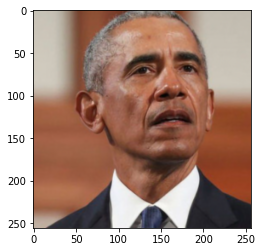

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1150, Total loss 0.000049


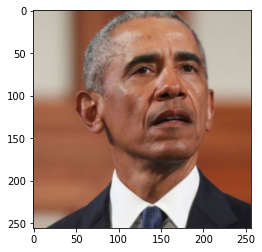

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1160, Total loss 0.000041


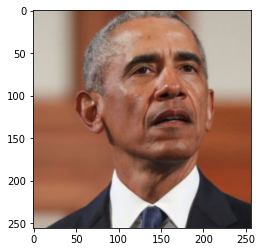

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1170, Total loss 0.000038


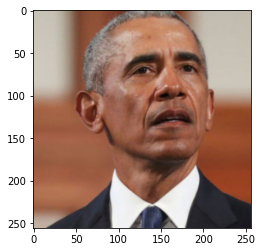

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1180, Total loss 0.000035


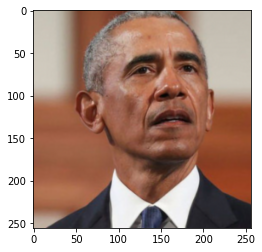

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1190, Total loss 0.000035


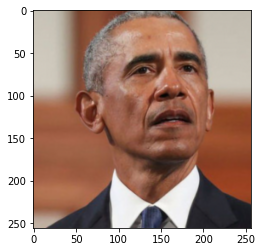

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1200, Total loss 0.000036


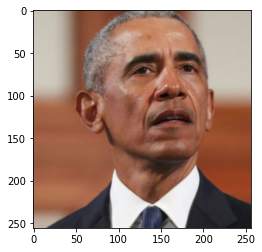

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1210, Total loss 0.000068


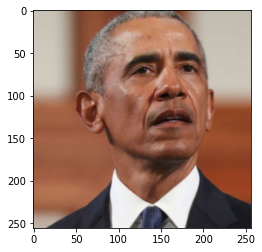

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1220, Total loss 0.000034


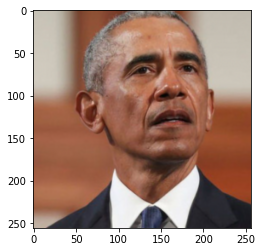

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1230, Total loss 0.000035


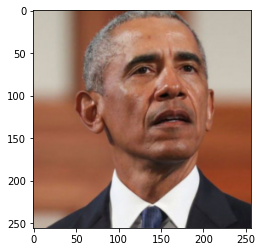

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1240, Total loss 0.000033


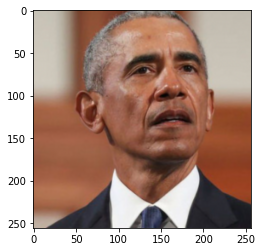

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1250, Total loss 0.000032


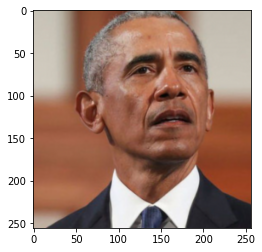

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1260, Total loss 0.000047


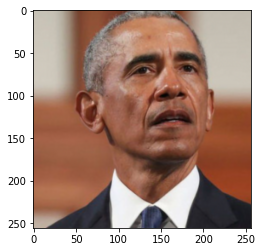

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1270, Total loss 0.000035


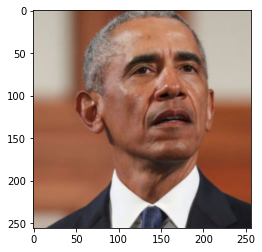

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1280, Total loss 0.000031


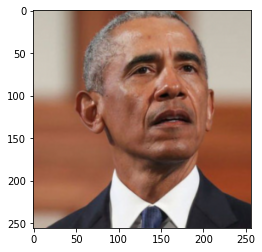

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1290, Total loss 0.000030


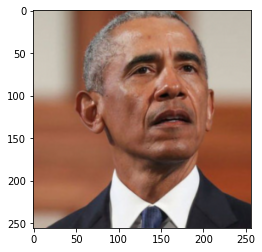

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1300, Total loss 0.000029


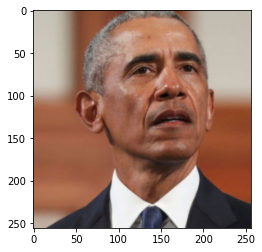

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1310, Total loss 0.000029


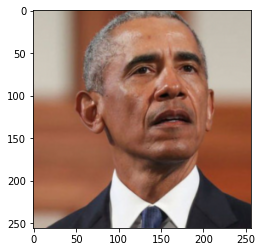

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1320, Total loss 0.000030


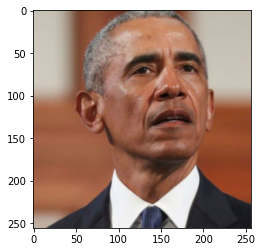

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1330, Total loss 0.000086


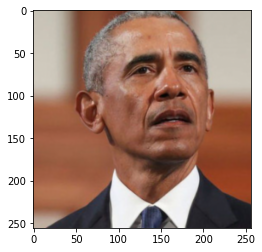

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1340, Total loss 0.000046


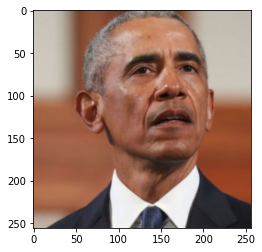

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1350, Total loss 0.000034


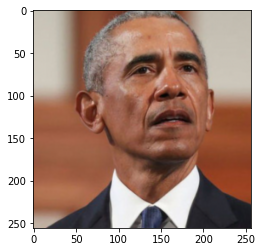

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1360, Total loss 0.000029


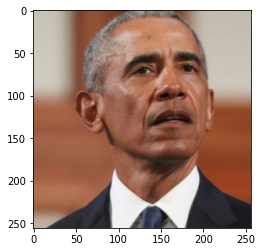

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1370, Total loss 0.000027


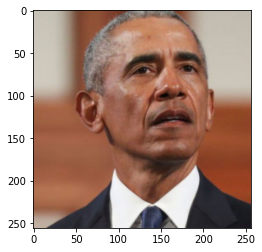

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1380, Total loss 0.000026


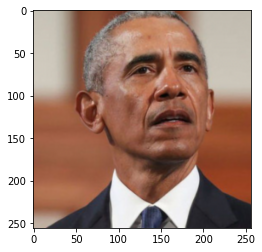

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1390, Total loss 0.000026


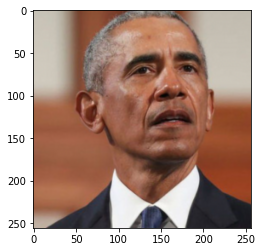

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1400, Total loss 0.000025


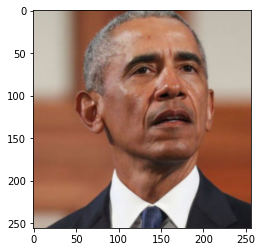

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1410, Total loss 0.000045


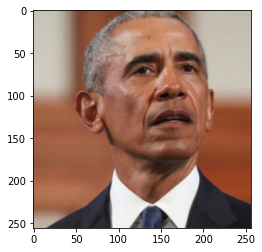

Step 1420, Total loss 0.000059


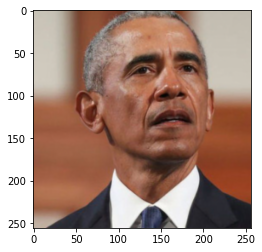

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1430, Total loss 0.000036


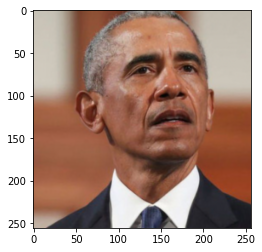

Step 1440, Total loss 0.000027


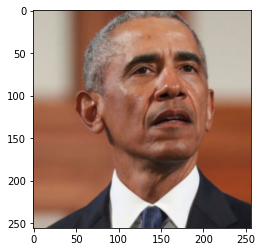

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1450, Total loss 0.000025


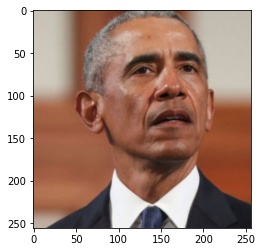

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1460, Total loss 0.000024


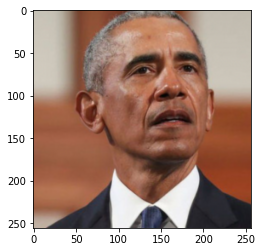

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1470, Total loss 0.000023


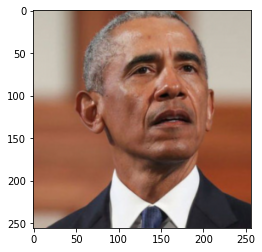

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1480, Total loss 0.000023


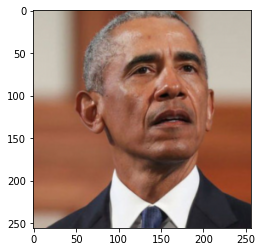

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1490, Total loss 0.000022


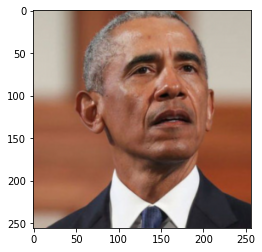

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1500, Total loss 0.000027


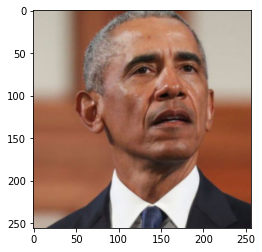

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1510, Total loss 0.000056


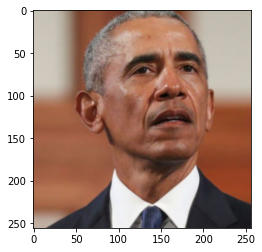

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1520, Total loss 0.000026


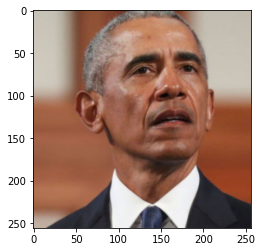

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1530, Total loss 0.000024


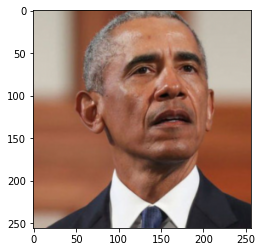

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1540, Total loss 0.000022


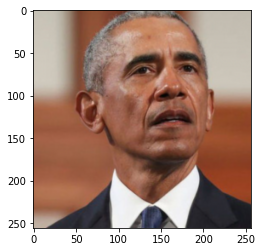

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1550, Total loss 0.000021


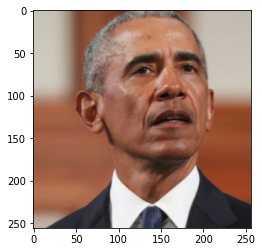

Step 1560, Total loss 0.000020


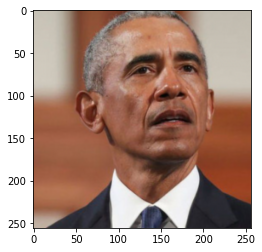

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1570, Total loss 0.000022


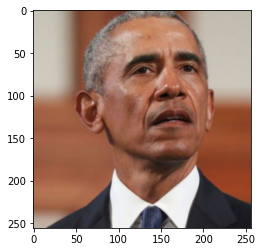

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1580, Total loss 0.000072


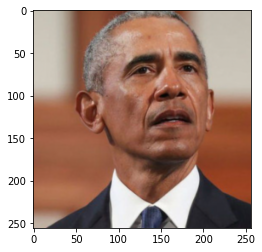

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1590, Total loss 0.000024


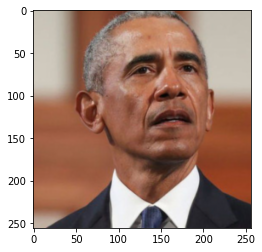

Step 1600, Total loss 0.000021


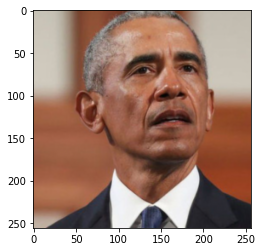

Step 1610, Total loss 0.000020


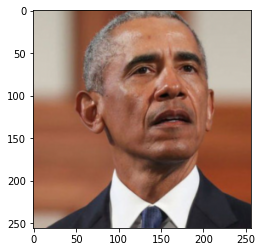

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1620, Total loss 0.000019


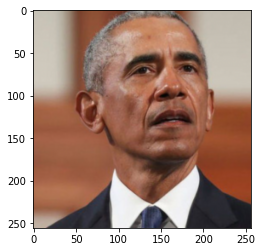

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1630, Total loss 0.000020


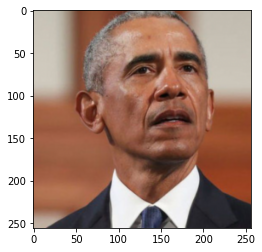

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1640, Total loss 0.000043


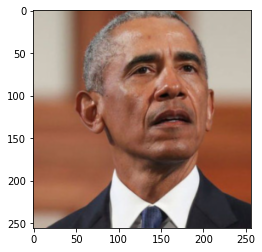

Step 1650, Total loss 0.000029


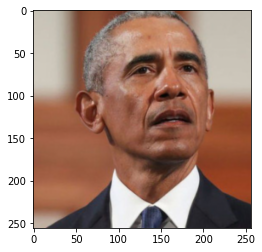

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1660, Total loss 0.000021


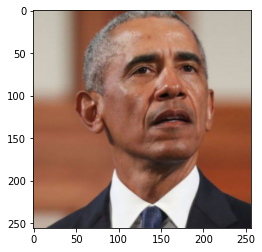

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1670, Total loss 0.000019


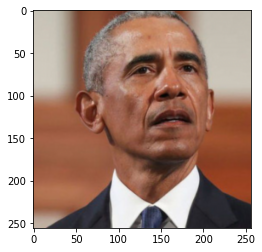

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1680, Total loss 0.000018


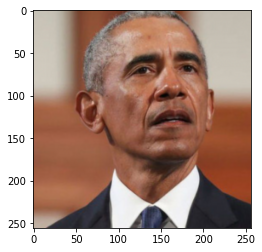

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1690, Total loss 0.000017


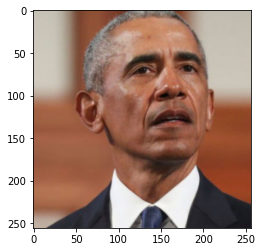

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1700, Total loss 0.000017


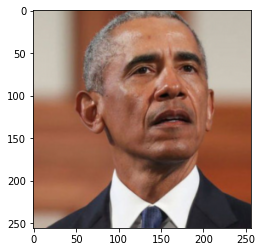

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1710, Total loss 0.000025


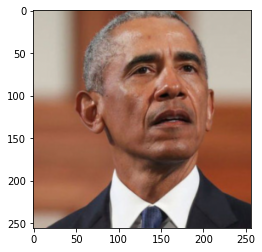

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1720, Total loss 0.000027


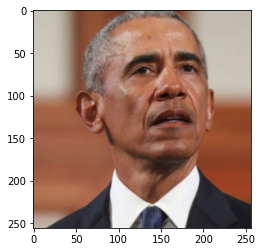

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1730, Total loss 0.000024


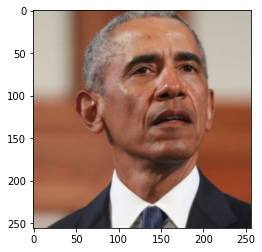

Step 1740, Total loss 0.000022


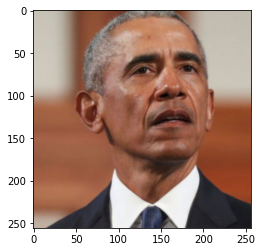

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1750, Total loss 0.000020


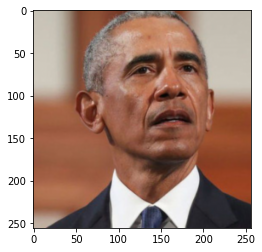

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1760, Total loss 0.000017


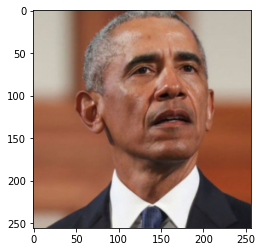

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1770, Total loss 0.000016


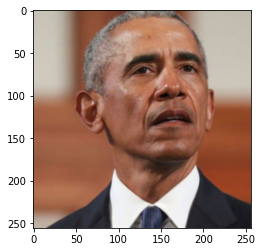

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1780, Total loss 0.000017


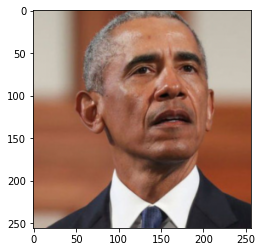

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1790, Total loss 0.000028


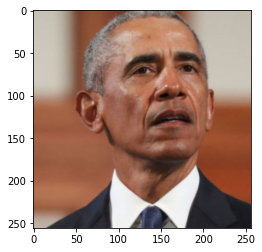

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1800, Total loss 0.000032


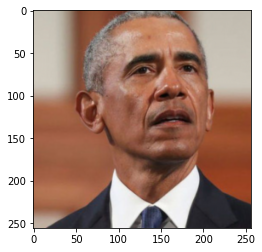

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1810, Total loss 0.000025


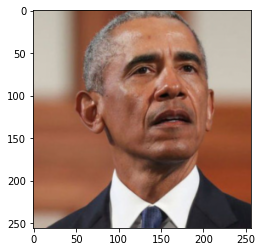

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1820, Total loss 0.000016


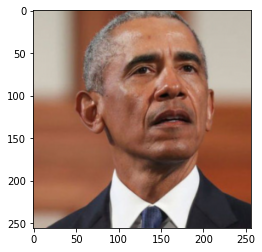

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1830, Total loss 0.000016


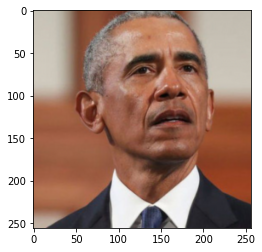

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1840, Total loss 0.000046


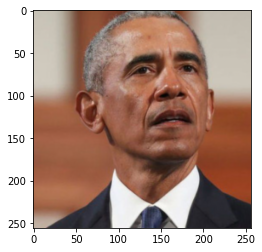

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1850, Total loss 0.000020


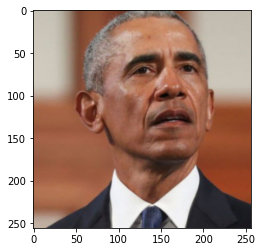

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1860, Total loss 0.000017


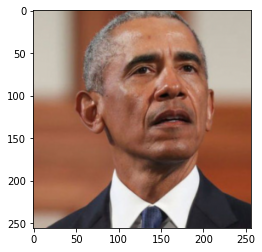

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1870, Total loss 0.000015


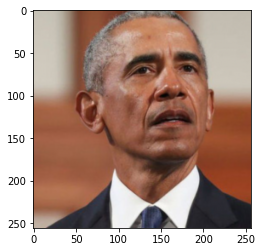

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1880, Total loss 0.000014


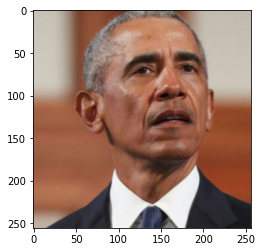

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1890, Total loss 0.000014


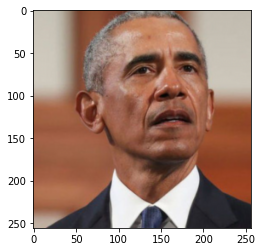

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1900, Total loss 0.000019


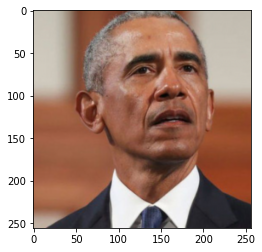

Step 1910, Total loss 0.000045


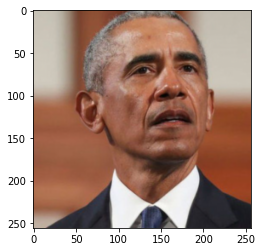

Step 1920, Total loss 0.000025


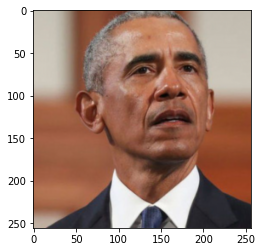

Step 1930, Total loss 0.000017


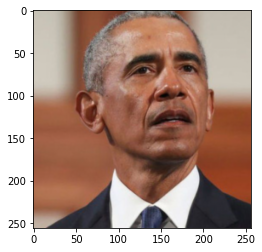

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1940, Total loss 0.000014


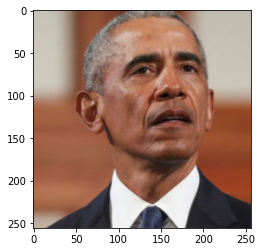

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1950, Total loss 0.000013


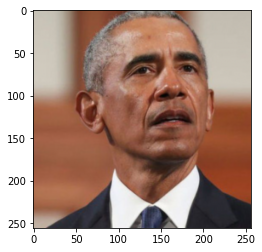

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1960, Total loss 0.000014


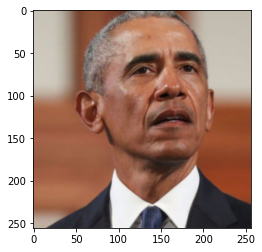

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1970, Total loss 0.000026


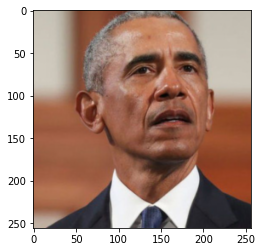

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1980, Total loss 0.000021


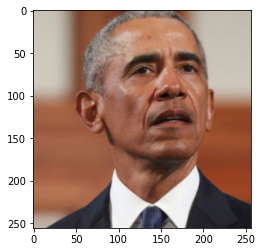

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1990, Total loss 0.000016


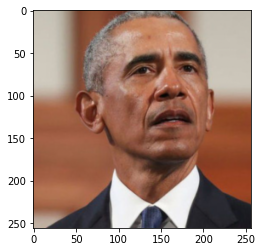

Step 2000, Total loss 0.000028


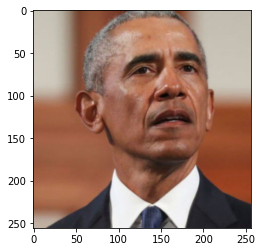

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2010, Total loss 0.000016


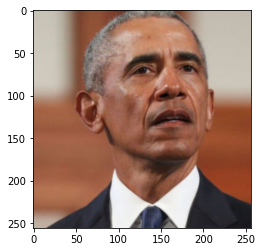

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2020, Total loss 0.000014


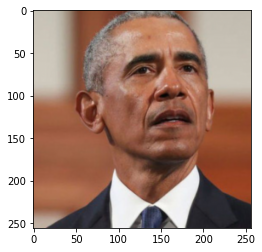

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2030, Total loss 0.000012


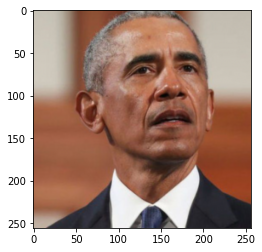

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2040, Total loss 0.000012


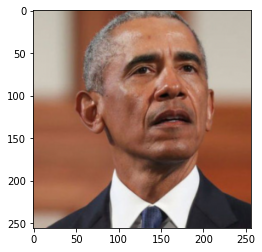

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2050, Total loss 0.000019


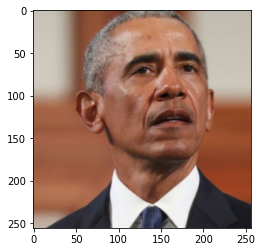

Step 2060, Total loss 0.000117


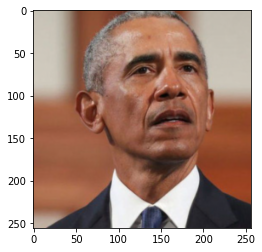

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2070, Total loss 0.000062


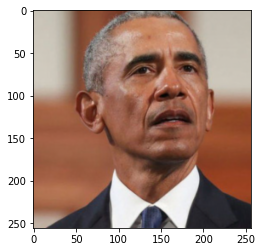

Step 2080, Total loss 0.000029


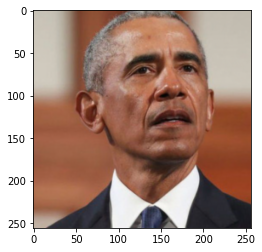

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2090, Total loss 0.000018


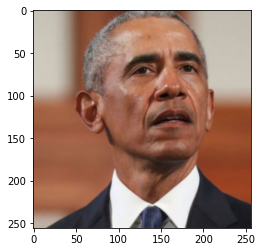

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2100, Total loss 0.000014


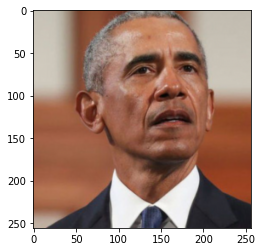

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2110, Total loss 0.000013


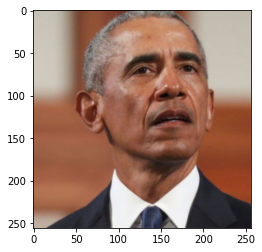

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2120, Total loss 0.000012


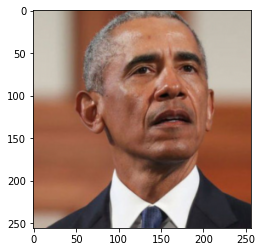

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2130, Total loss 0.000011


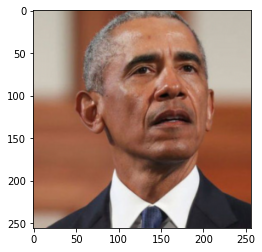

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2140, Total loss 0.000011


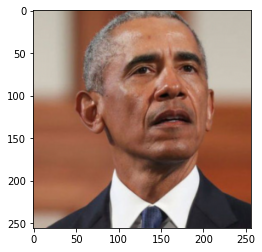

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2150, Total loss 0.000011


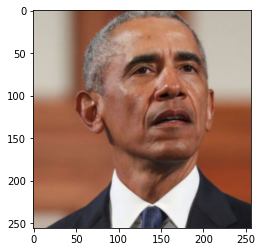

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2160, Total loss 0.000011


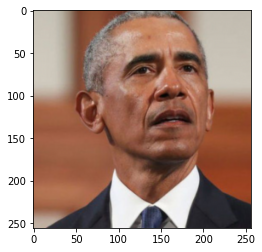

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2170, Total loss 0.000011


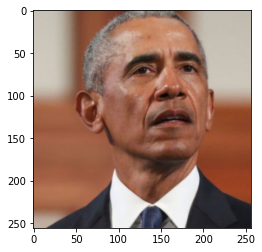

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2180, Total loss 0.000012


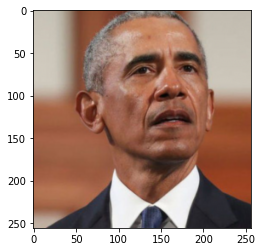

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2190, Total loss 0.000064


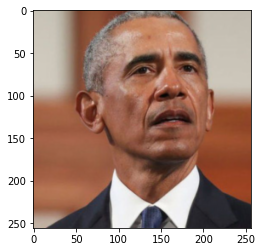

Step 2200, Total loss 0.000019


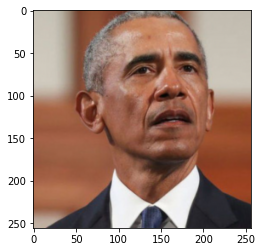

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2210, Total loss 0.000013


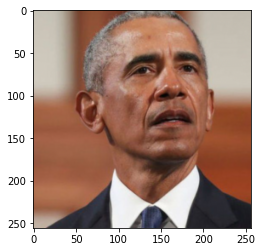

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2220, Total loss 0.000011


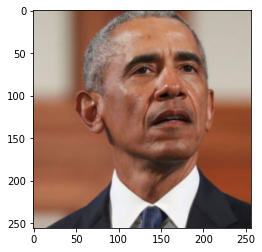

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2230, Total loss 0.000011


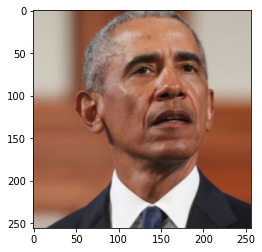

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2240, Total loss 0.000010


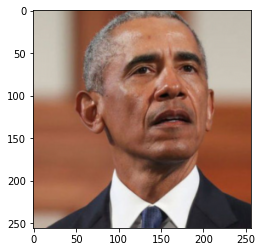

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2250, Total loss 0.000010


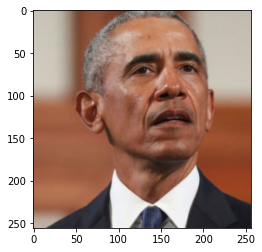

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2260, Total loss 0.000010


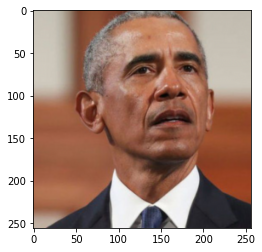

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2270, Total loss 0.000010


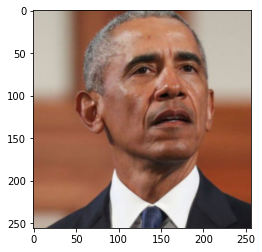

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2280, Total loss 0.000027


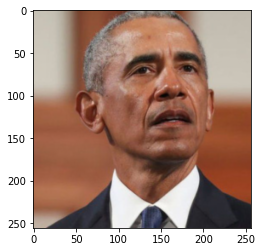

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2290, Total loss 0.000033


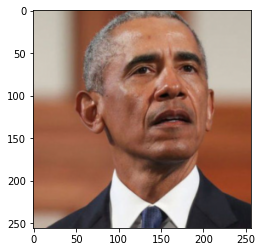

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2300, Total loss 0.000019


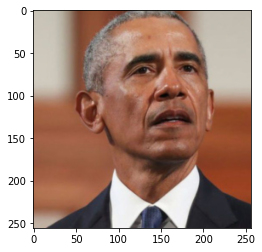

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2310, Total loss 0.000012


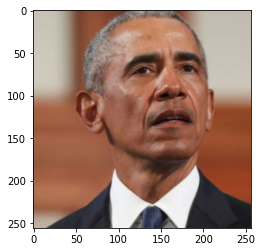

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2320, Total loss 0.000010


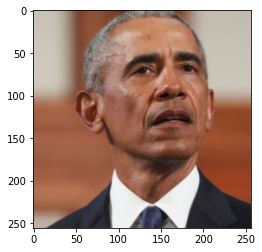

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2330, Total loss 0.000010


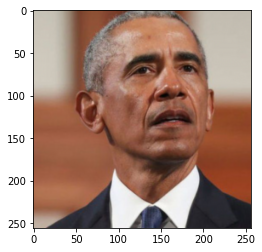

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2340, Total loss 0.000009


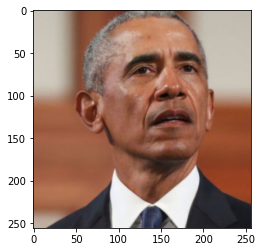

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2350, Total loss 0.000009


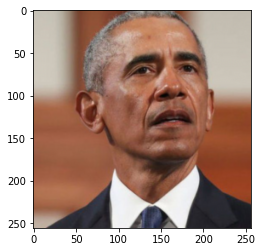

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2360, Total loss 0.000009


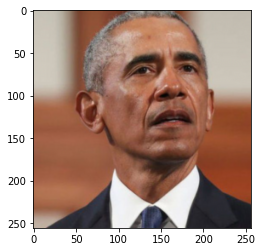

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2370, Total loss 0.000013


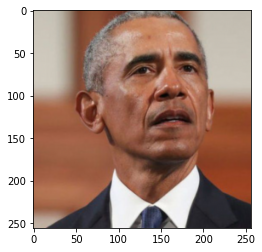

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2380, Total loss 0.000786


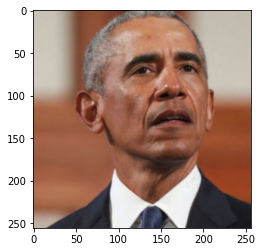

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2390, Total loss 0.013305


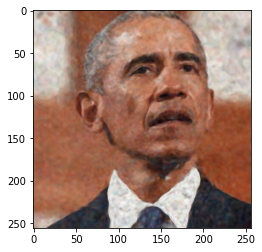

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2400, Total loss 0.007644


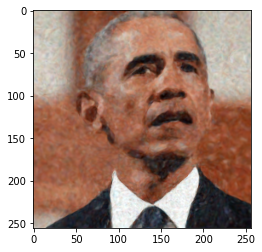

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2410, Total loss 0.002134


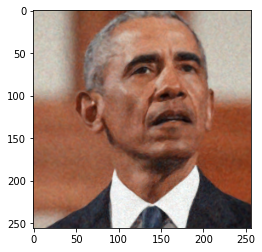

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2420, Total loss 0.000925


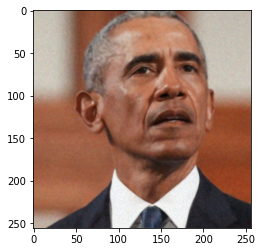

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2430, Total loss 0.000486


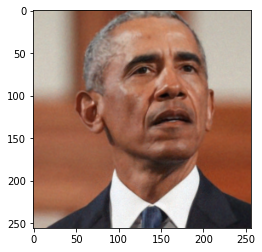

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2440, Total loss 0.000305


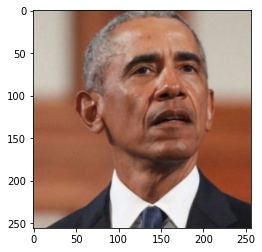

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2450, Total loss 0.000222


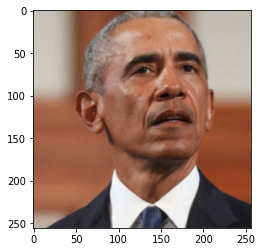

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2460, Total loss 0.000178


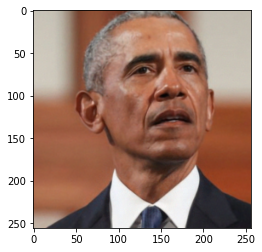

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2470, Total loss 0.000151


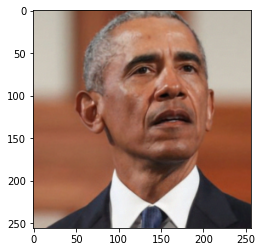

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2480, Total loss 0.000133


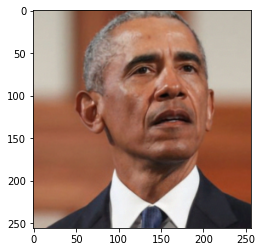

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2490, Total loss 0.000120


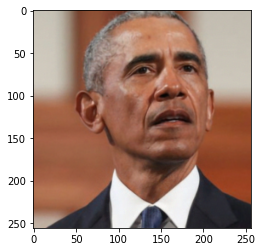

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2500, Total loss 0.000110


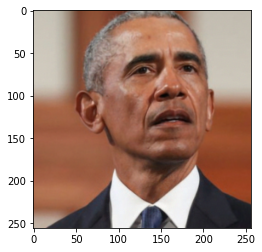

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2510, Total loss 0.000101


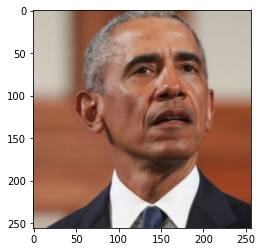

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2520, Total loss 0.000094


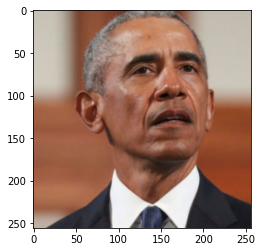

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2530, Total loss 0.000088


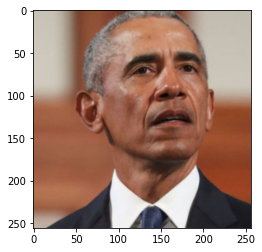

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2540, Total loss 0.000082


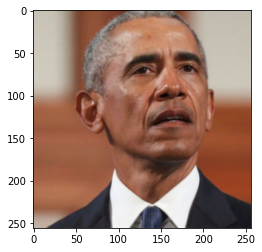

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2550, Total loss 0.000078


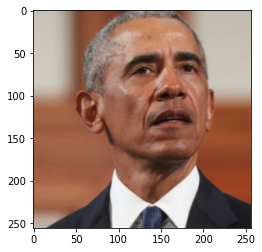

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2560, Total loss 0.000073


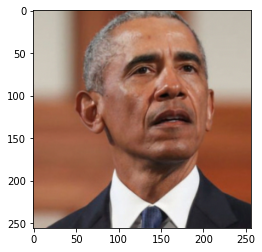

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2570, Total loss 0.000070


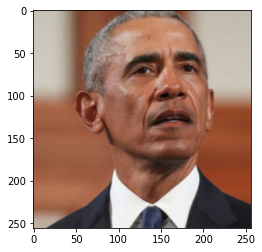

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2580, Total loss 0.000066


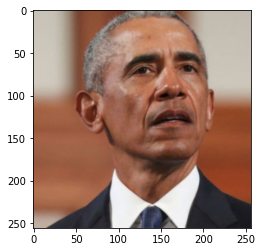

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2590, Total loss 0.000063


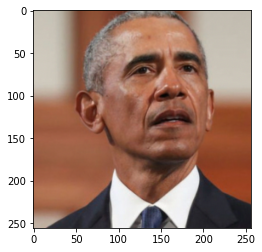

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2600, Total loss 0.000060


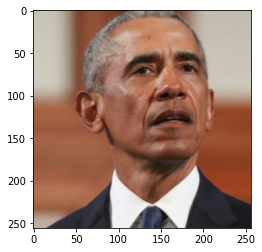

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2610, Total loss 0.000058


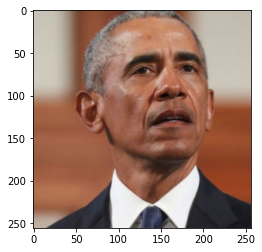

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2620, Total loss 0.000055


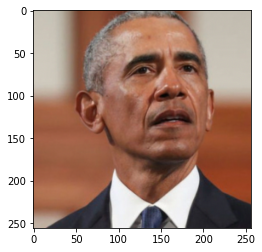

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2630, Total loss 0.000053


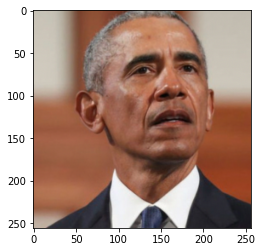

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2640, Total loss 0.000051


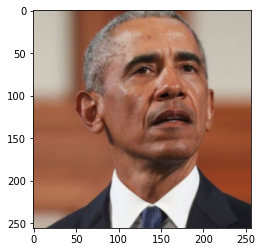

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2650, Total loss 0.000049


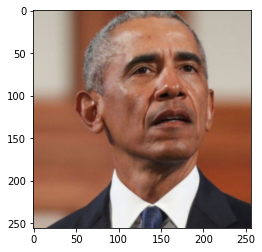

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2660, Total loss 0.000047


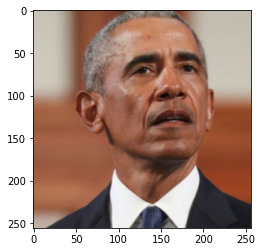

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2670, Total loss 0.000046


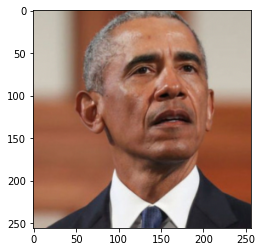

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2680, Total loss 0.000044


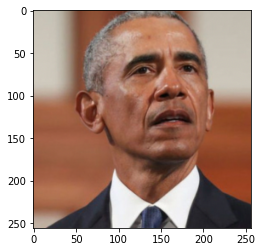

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2690, Total loss 0.000043


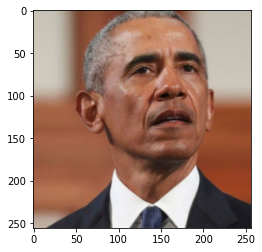

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2700, Total loss 0.000041


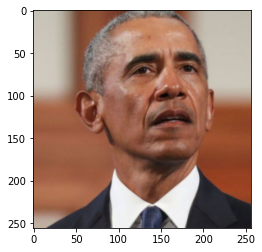

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2710, Total loss 0.000040


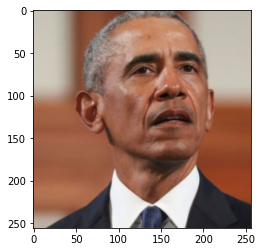

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2720, Total loss 0.000039


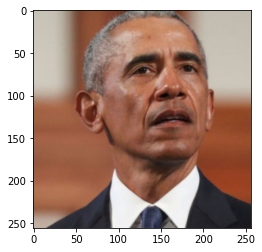

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2730, Total loss 0.000038


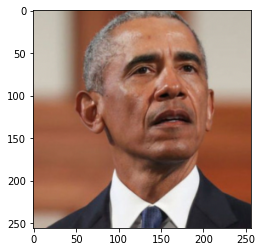

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2740, Total loss 0.000036


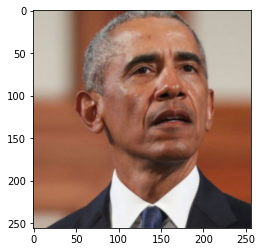

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2750, Total loss 0.000035


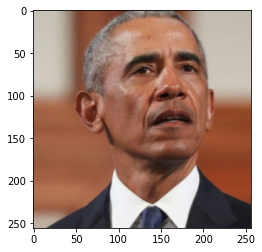

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2760, Total loss 0.000034


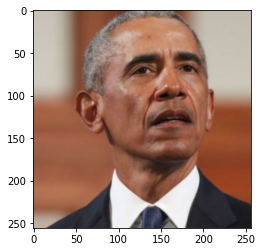

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2770, Total loss 0.000033


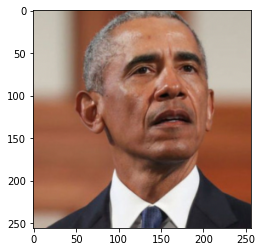

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2780, Total loss 0.000033


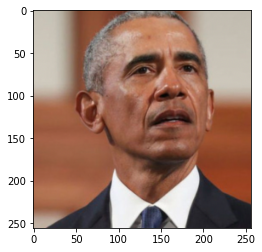

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2790, Total loss 0.000032


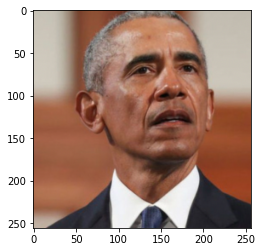

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2800, Total loss 0.000031


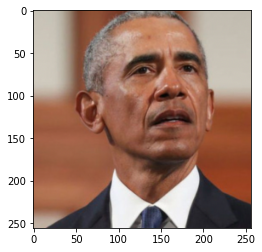

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2810, Total loss 0.000030


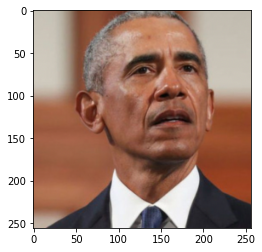

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2820, Total loss 0.000029


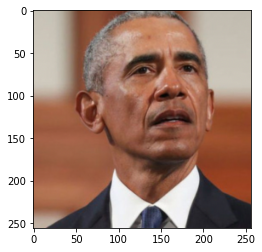

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2830, Total loss 0.000029


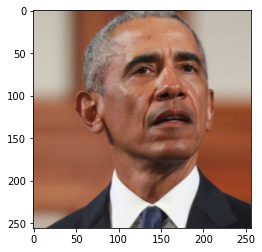

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2840, Total loss 0.000028


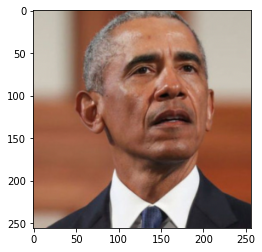

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2850, Total loss 0.000027


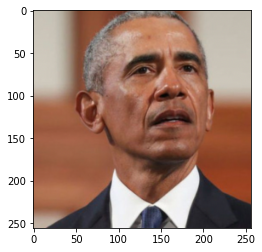

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2860, Total loss 0.000027


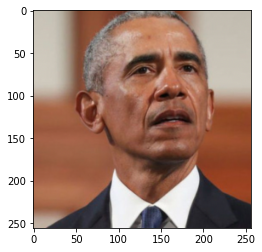

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2870, Total loss 0.000026


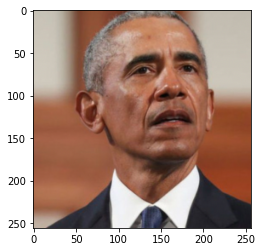

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2880, Total loss 0.000026


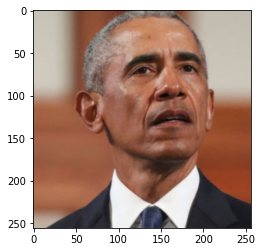

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2890, Total loss 0.000025


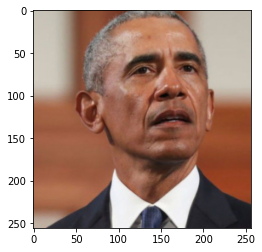

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2900, Total loss 0.000024


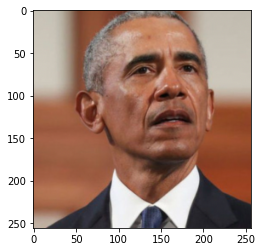

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2910, Total loss 0.000024


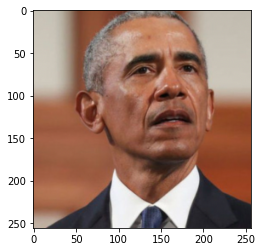

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2920, Total loss 0.000023


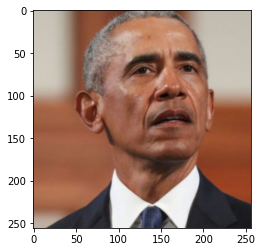

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2930, Total loss 0.000023


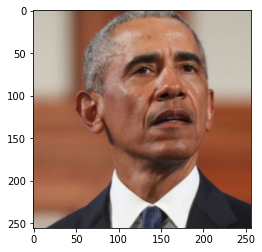

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2940, Total loss 0.000023


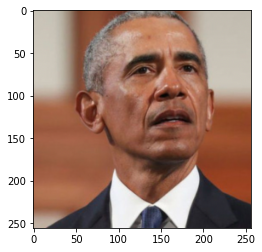

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2950, Total loss 0.000022


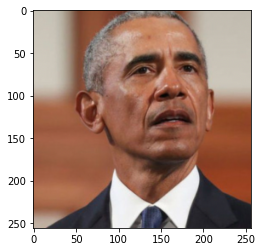

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2960, Total loss 0.000022


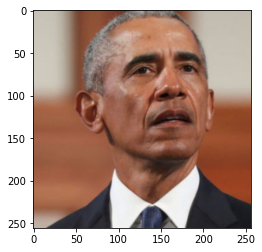

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2970, Total loss 0.000021


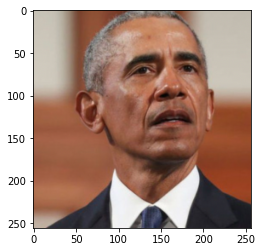

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2980, Total loss 0.000021


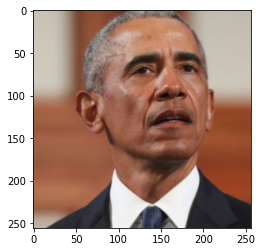

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2990, Total loss 0.000020


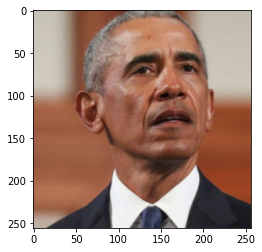

In [122]:
total_steps = 3000
steps_til_summary = 10

optim = torch.optim.Adam(lr=1e-4, params=net.parameters()) 

model_input, ground_truth = next(iter(dataloader))
model_input, ground_truth = model_input.cuda(), ground_truth.cuda()

for step in range(total_steps):
  model_output, coords = net(model_input)
  loss = ((model_output - ground_truth)**2).mean()
  if not step % steps_til_summary:
    print(f"Step {step}, Total loss {loss:0.6f}")
    plt.imshow(model_output.cpu().view(sideX, sideX, 3).detach().numpy()*.5 + .5)
    plt.show()

  optim.zero_grad()
  loss.backward()
  optim.step()

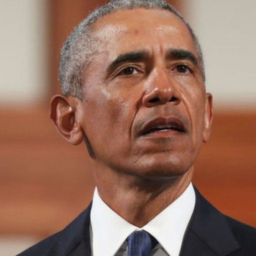

In [123]:
out = model_output.view(sideX,sideX,3).cpu().detach()
# plt.imshow(out*.5+.5)
T.ToPILImage()((out*.5+.5).permute(2,0,1).clip(0.,1.))

In [124]:
# torch.save(net.state_dict(), "/content/obama_better.pkl")

## Optimizing with CLIP - Global Directions method

The flow is as follows:  
We input two prompts, a neutral prompt and a positive prompt. From that we generate a direction in CLIP-space $\Delta t$ (+prompt engineering as is done in styleCLIP paper). We then optimize the following
$$\text{argmin}_{\theta_{\text{SIREN}}} 1-\langle\Delta i, \Delta t\rangle$$
where $$\Delta i = i_\theta - i_{\text{orig}}\quad\text{ normalized}$$

In [14]:
import clip

model, preprocess = clip.load("ViT-B/32", device='cuda')
model.eval();

100%|███████████████████████████████████████| 338M/338M [00:04<00:00, 75.7MiB/s]


### Reload model weights
reload fitted model weights (if necessary)

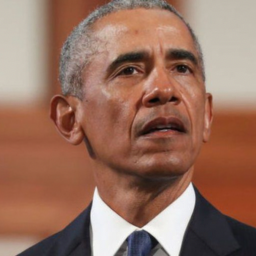

In [15]:
def reload_model(weights="/content/obama_better.pkl"):
  global net
  net.load_state_dict(torch.load(weights))
  model_input = get_mgrid(256, 2).cuda()
  with torch.no_grad():
    out = net(model_input)[0].view(sideX,sideX,3).cpu().detach()
  loaded_output = T.ToPILImage()((out*.5+.5).permute(2,0,1).clip(0.,1.))
  return loaded_output

def compare(original, manipulated):
  plt.figure(figsize=(15,7), dpi= 100)
  plt.subplot(1,2,1)
  plt.imshow(original.detach().cpu()[0].permute(1,2,0).numpy()*.5 +.5)
  plt.title('original')
  plt.axis('off')
  plt.subplot(1,2,2)
  plt.imshow(manipulated.detach().cpu()[0].permute(1,2,0).numpy()*.5 +.5)
  plt.title('manipulated')
  plt.axis('off')
  
reload_model()

In [16]:
#@markdown imagenet templates

imagenet_templates = [
    'a bad photo of a {}.',
#    'a photo of many {}.',
    'a sculpture of a {}.',
    'a photo of the hard to see {}.',
    'a low resolution photo of the {}.',
    'a rendering of a {}.',
    'graffiti of a {}.',
    'a bad photo of the {}.',
    'a cropped photo of the {}.',
    'a tattoo of a {}.',
    'the embroidered {}.',
    'a photo of a hard to see {}.',
    'a bright photo of a {}.',
    'a photo of a clean {}.',
    'a photo of a dirty {}.',
    'a dark photo of the {}.',
    'a drawing of a {}.',
    'a photo of my {}.',
    'the plastic {}.',
    'a photo of the cool {}.',
    'a close-up photo of a {}.',
    'a black and white photo of the {}.',
    'a painting of the {}.',
    'a painting of a {}.',
    'a pixelated photo of the {}.',
    'a sculpture of the {}.',
    'a bright photo of the {}.',
    'a cropped photo of a {}.',
    'a plastic {}.',
    'a photo of the dirty {}.',
    'a jpeg corrupted photo of a {}.',
    'a blurry photo of the {}.',
    'a photo of the {}.',
    'a good photo of the {}.',
    'a rendering of the {}.',
    'a {} in a video game.',
    'a photo of one {}.',
    'a doodle of a {}.',
    'a close-up photo of the {}.',
    'a photo of a {}.',
    'the origami {}.',
    'the {} in a video game.',
    'a sketch of a {}.',
    'a doodle of the {}.',
    'a origami {}.',
    'a low resolution photo of a {}.',
    'the toy {}.',
    'a rendition of the {}.',
    'a photo of the clean {}.',
    'a photo of a large {}.',
    'a rendition of a {}.',
    'a photo of a nice {}.',
    'a photo of a weird {}.',
    'a blurry photo of a {}.',
    'a cartoon {}.',
    'art of a {}.',
    'a sketch of the {}.',
    'a embroidered {}.',
    'a pixelated photo of a {}.',
    'itap of the {}.',
    'a jpeg corrupted photo of the {}.',
    'a good photo of a {}.',
    'a plushie {}.',
    'a photo of the nice {}.',
    'a photo of the small {}.',
    'a photo of the weird {}.',
    'the cartoon {}.',
    'art of the {}.',
    'a drawing of the {}.',
    'a photo of the large {}.',
    'a black and white photo of a {}.',
    'the plushie {}.',
    'a dark photo of a {}.',
    'itap of a {}.',
    'graffiti of the {}.',
    'a toy {}.',
    'itap of my {}.',
    'a photo of a cool {}.',
    'a photo of a small {}.',
    'a tattoo of the {}.',
]

In [17]:
# REF from styleCLIP

def zeroshot_classifier(classnames, templates, model):
    with torch.no_grad():
        zeroshot_weights = []
        for classname in classnames:
            texts = [template.format(classname) for template in templates] #format with class
            texts = clip.tokenize(texts).cuda() #tokenize
            class_embeddings = model.encode_text(texts) #embed with text encoder
            class_embeddings /= class_embeddings.norm(dim=-1, keepdim=True)
            class_embedding = class_embeddings.mean(dim=0)
            class_embedding /= class_embedding.norm()
            zeroshot_weights.append(class_embedding)
        zeroshot_weights = torch.stack(zeroshot_weights, dim=1).cuda()
    return zeroshot_weights

def GetDt(classnames,model):
    text_features=zeroshot_classifier(classnames, imagenet_templates,model).t()
    
    dt=text_features[0]-text_features[1]
    dt=dt.cpu().numpy()
    
#    t_m1=t_m/np.linalg.norm(t_m)
#    dt=text_features.cpu().numpy()[0]-t_m1
    print(np.linalg.norm(dt))
    dt=dt/np.linalg.norm(dt)
    return dt

In [18]:
def get_dt(neutral_prompt, positive_prompt):
  # TODO rewrite
  return GetDt([neutral_prompt, positive_prompt], model)

def get_di(output, original):
  from torch.nn.functional import interpolate
  # output = interpolate(output, (224,224), mode='bilinear')#preprocess(output)
  # original = interpolate(original, (224,224), mode='bilinear')#preprocess(original) # can actually do this once
  image_input = torch.cat([output, original])#.cuda()
  # with torch.no_grad(): #hmm, i dont want clip weights gradient but i do want siren...
  image_features = model.encode_image(image_input).float()
  image_features = image_features / image_features.norm(dim=-1, keepdim=True) # todo figure out exactly the -1
  di = image_features[0] - image_features[1]
  di = di / di.norm() # enough?
  return di

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0.11786


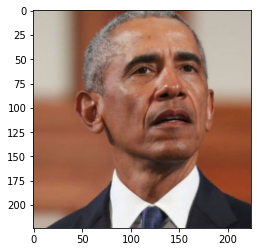

In [19]:
sideCLIP = model.visual.input_resolution
clip_coords = get_mgrid(sideCLIP, 2).cuda()
neutral_prompt = "a man with a nose"
positive_prompt = "a man with a small nose"
dt = torch.tensor(get_dt(neutral_prompt, positive_prompt)).float().cuda()
with torch.no_grad():
  model_output = net(clip_coords)[0].view(sideCLIP,sideCLIP,3).cpu().detach()
  plt.imshow(model_output*.5+.5)
  original_im = model_output.permute(2,0,1).unsqueeze(0).cuda()

### CLIP loss verification
TODO, but how?

### Optimization loop with CLIP loss

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 0, Total loss 1.001846


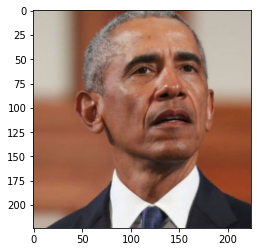

Step 25, Total loss 0.615832


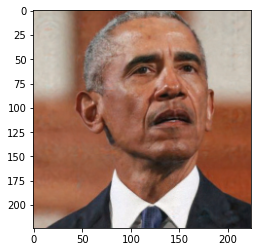

Step 50, Total loss 0.474870


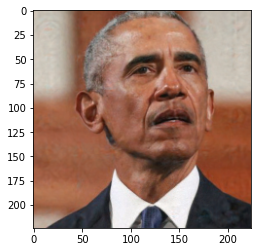

Step 75, Total loss 0.373733


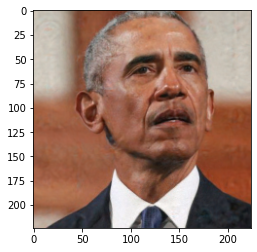

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 100, Total loss 0.293012


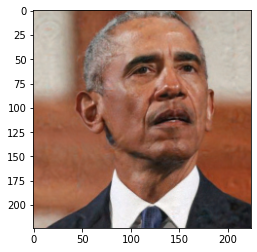

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 125, Total loss 0.229136


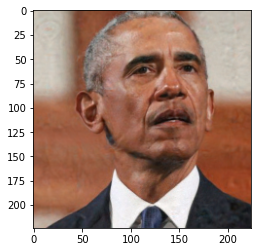

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 150, Total loss 0.181947


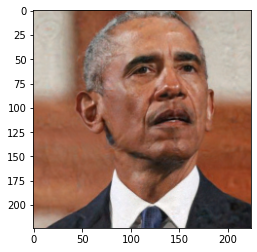

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 175, Total loss 0.148241


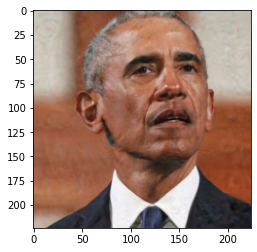

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 200, Total loss 0.142534


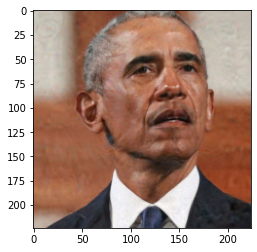

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 225, Total loss 0.109576


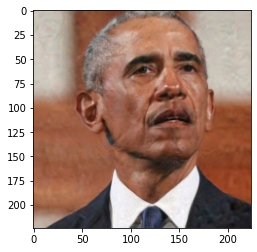

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 250, Total loss 0.091685


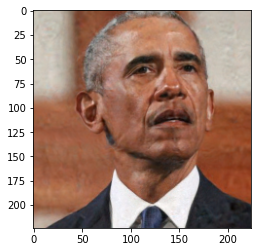

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 275, Total loss 0.086040


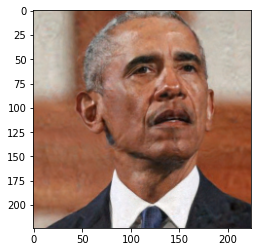

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


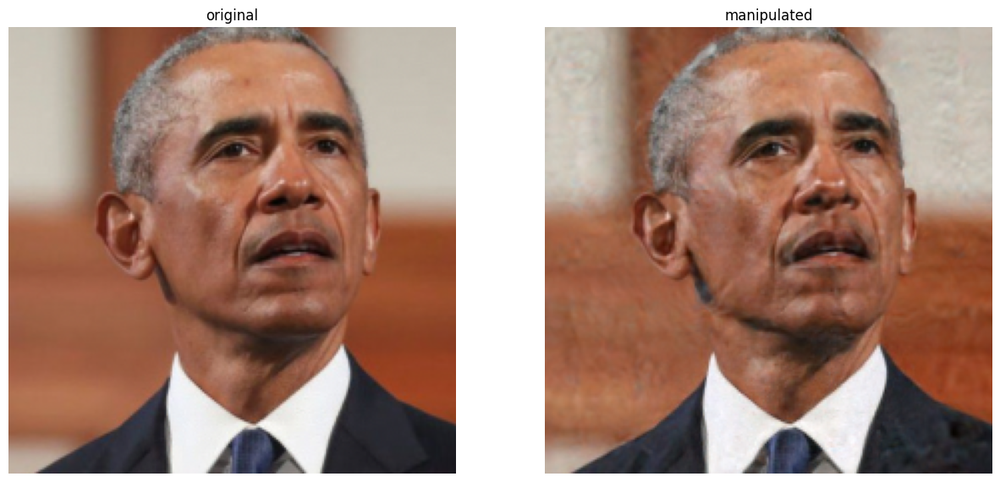

In [194]:
reload_model()
total_steps = 300
steps_til_summary = 25

optim = torch.optim.Adam(lr=1e-5, params=net.parameters()) 

for step in range(total_steps):

  model_output, coords = net(clip_coords)
  shaped = model_output.view(sideCLIP,sideCLIP,3).permute(2,0,1).unsqueeze(0)
  if step == 0:
    di = get_di(shaped+torch.normal(0.,0.00001,size=shaped.shape).cuda(), original_im).cuda()
  else:
    di = get_di(shaped, original_im).cuda()
  loss = 1 - di @ dt.T# + lambda_2*((shaped - original_im)**2).mean() #torch.dot(di, dt)
  if not step % steps_til_summary:
    print(f"Step {step}, Total loss {loss:0.6f}")
    plt.imshow(shaped.detach().cpu()[0].permute(1,2,0).numpy()*.5 +.5)
    plt.show()

  optim.zero_grad()
  loss.backward()
  optim.step()
compare(original_im, shaped)

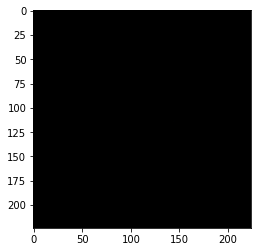

In [197]:
plt.imshow((shaped - original_im)[0].permute(1,2,0).detach().cpu().abs())

### Optimization loop with some regularization?

In [ ]:
reload_model()
total_steps = 100
steps_til_summary = 25
lambda2 = 100.

optim = torch.optim.Adam(lr=1e-6, params=net.parameters()) 

for step in range(total_steps):

  model_output, coords = net(clip_coords)
  shaped = model_output.view(sideCLIP,sideCLIP,3).permute(2,0,1).unsqueeze(0)
  if step == 0:
    di = get_di(shaped+torch.normal(0.,0.00001,size=shaped.shape).cuda(), original_im).cuda()
  else:
    di = get_di(shaped, original_im).cuda()
  loss = 1 - di @ dt.T + lambda_2*((shaped - original_im)**2).mean() #torch.dot(di, dt)
  if not step % steps_til_summary:
    print(f"Step {step}, Total loss {loss:0.6f}")
    plt.imshow(shaped.detach().cpu()[0].permute(1,2,0).numpy()*.5 +.5)
    plt.show()

  optim.zero_grad()
  loss.backward()
  optim.step()